(4024, 4024)
max=255, count=10121
(1006, 1006)


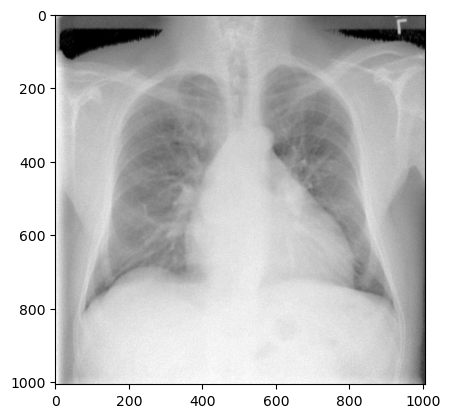

In [50]:
import torch
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
import numpy as np
from collections import defaultdict, Counter
from sklearn.linear_model import LinearRegression
from torchvision import transforms
import torch.functional as F
import torch.nn as nn

camera_image_full = np.array(Image.open('camera_sim_full.tif'), dtype=np.float32)
print(camera_image_full.shape)
downsampled = nn.AvgPool2d(4) (torch.from_numpy(camera_image_full).unsqueeze(0)).squeeze().numpy()

high = np.percentile(downsampled, 99)
low = np.percentile(downsampled, 1)

downsampled = (downsampled - low) / (high - low)
downsampled = downsampled.clip(0, 1.0)
downsampled *= 255
downsampled = downsampled.astype(np.uint8)

plt.imshow(downsampled, vmin=0, vmax=255, cmap="gray")

print(f"max={downsampled.max()}, count={np.count_nonzero(downsampled == downsampled.max())}")



print(downsampled.shape)



camera_sim_bined_and_norm = Image.fromarray(downsampled, mode="L")


camera_sim_bined_and_norm.save("camera_sim_bined_and_norm.png")


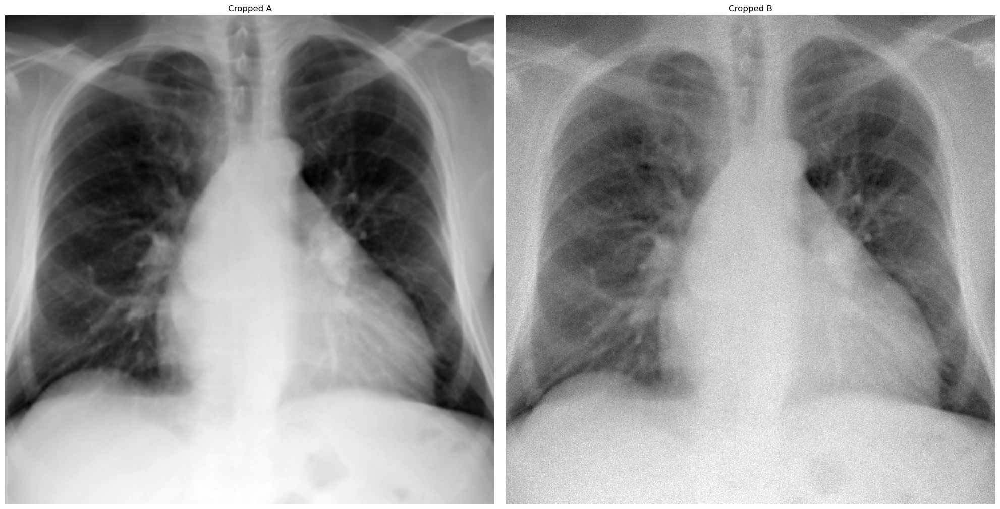

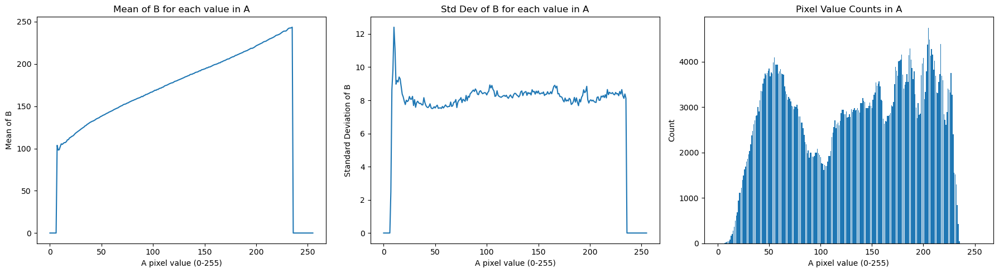

Linear Regression: y = 0.5622 * x + 109.8140


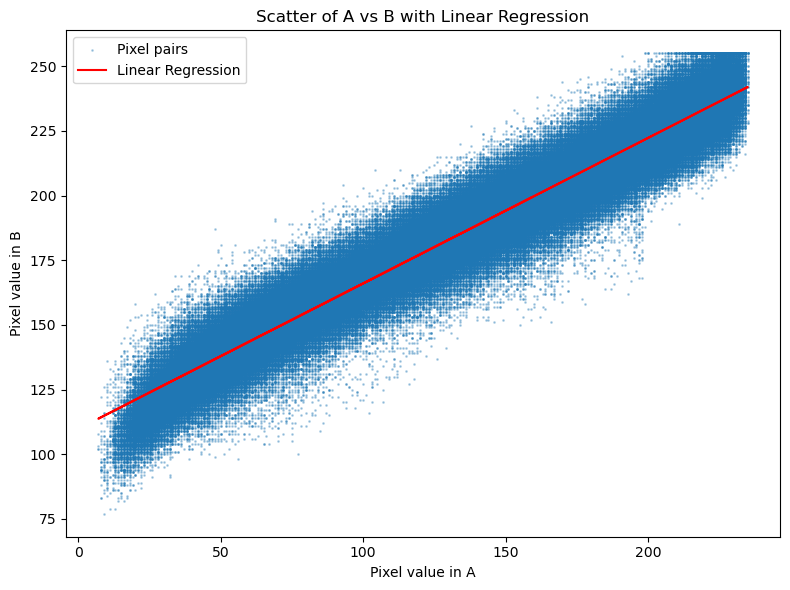

In [51]:
import torch
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
import numpy as np
from collections import defaultdict, Counter
from sklearn.linear_model import LinearRegression
from torchvision import transforms

# Parameters
CROP_SIZE = (800, 800)
APPLY_GAUSSIAN_BLUR = True # Set to True to enable Gaussian blur on A
BLUR_SIGMA = 1.5


# Load images
image_a: Image = Image.open('nih.png').convert('L')  # Grayscale (uint8)
image_b: Image = Image.open('camera_sim_bined_and_norm.png').convert('L')  # Grayscale (uint8)

# Resize A to match B if needed
if image_a.size != image_b.size:
    image_a = image_a.resize(image_b.size, Image.BILINEAR)

# Convert to tensors
A = torch.from_numpy(np.array(image_a)).to(torch.uint8)
B = torch.from_numpy(np.array(image_b)).float()  # Convert to float for stats

if APPLY_GAUSSIAN_BLUR:
    A = transforms.GaussianBlur(11, BLUR_SIGMA)(A.unsqueeze(0)).squeeze()

assert A.shape == B.shape, "Images must be the same size"


# Center crop
def center_crop(tensor, size):
    h, w = tensor.shape
    ch, cw = size
    start_y = (h - ch) // 2
    start_x = (w - cw) // 2
    return tensor[start_y:start_y+ch, start_x:start_x+cw]

A_full = A
B_full = B

A = center_crop(A, CROP_SIZE)
B = center_crop(B, CROP_SIZE)

# Show cropped A and B
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(A.numpy(), cmap='gray')
plt.title('Cropped A')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(B.numpy(), cmap='gray')
plt.title('Cropped B')
plt.axis('off')

plt.tight_layout()
plt.show()

# Group B values by A's pixel values
value_dict = defaultdict(list)
counts = Counter(A.flatten().tolist())
for i in range(256):
    mask = (A == i)
    if mask.any():
        value_dict[i] = B[mask].tolist()

# Compute statistics
means = []
stds = []
count_list = []
indices = range(256)
for i in indices:
    values = value_dict[i]
    if values:
        mean = np.mean(values)
        std = np.std(values)
        count = counts[i]
    else:
        mean = 0
        std = 0
        count = 0
    means.append(mean)
    stds.append(std)
    count_list.append(count)

# Plot statistics
plt.figure(figsize=(18, 5))
plt.subplot(1, 3, 1)
plt.plot(indices, means)
plt.title('Mean of B for each value in A')
plt.xlabel('A pixel value (0-255)')
plt.ylabel('Mean of B')

plt.subplot(1, 3, 2)
plt.plot(indices, stds)
plt.title('Std Dev of B for each value in A')
plt.xlabel('A pixel value (0-255)')
plt.ylabel('Standard Deviation of B')

plt.subplot(1, 3, 3)
plt.bar(indices, count_list)
plt.title('Pixel Value Counts in A')
plt.xlabel('A pixel value (0-255)')
plt.ylabel('Count')

plt.tight_layout()
plt.show()

# Store pixel pairs and perform linear regression
pairs = [(a.item(), b.item()) for a, b in zip(A.flatten(), B.flatten())]
pairs = np.array(pairs)
X = pairs[:, 0].reshape(-1, 1)  # A values
y = pairs[:, 1]  # B values

# Fit linear regression
model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)

# Print regression coefficients
print(f"Linear Regression: y = {model.coef_[0]:.4f} * x + {model.intercept_:.4f}")

# Plot scatter and regression line
plt.figure(figsize=(8, 6))
plt.scatter(X, y, s=1, alpha=0.3, label='Pixel pairs')
plt.plot(X, y_pred, color='red', label='Linear Regression')
plt.title('Scatter of A vs B with Linear Regression')
plt.xlabel('Pixel value in A')
plt.ylabel('Pixel value in B')
plt.legend()
plt.tight_layout()
plt.show()


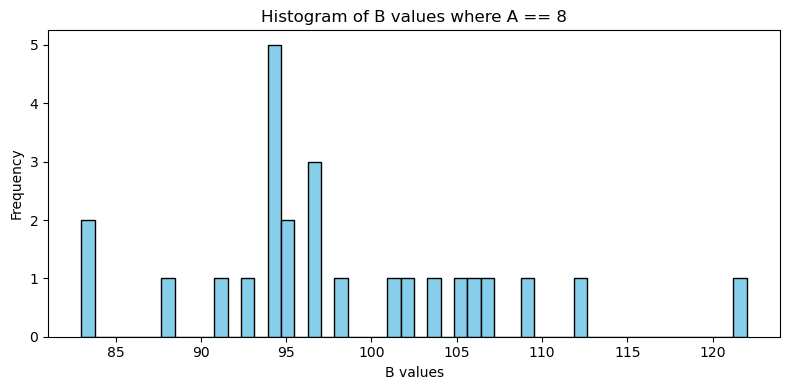

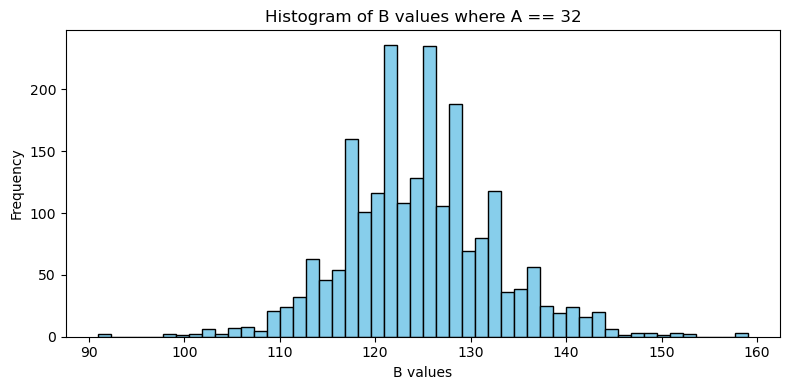

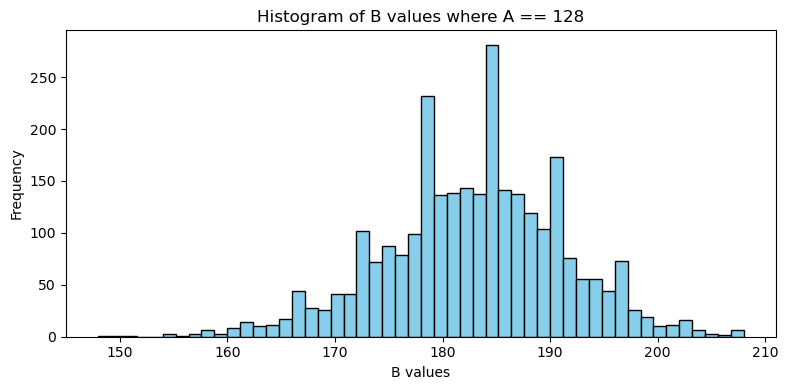

In [52]:

# Histogram of B values for a given A value
example_values =  [8, 32, 128]  # Change this to inspect other A values
for example_value in example_values:
    if value_dict[example_value]:
        plt.figure(figsize=(8, 4))
        plt.hist(value_dict[example_value], bins=50, color='skyblue', edgecolor='black')
        plt.title(f'Histogram of B values where A == {example_value}')
        plt.xlabel('B values')
        plt.ylabel('Frequency')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No pixels in A with value {example_value}.")


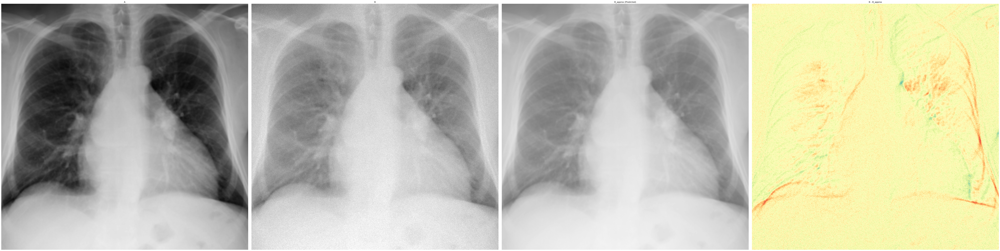

Mean diff: tensor(6.5154, dtype=torch.float64)
MSE: tensor(69.0060, dtype=torch.float64)


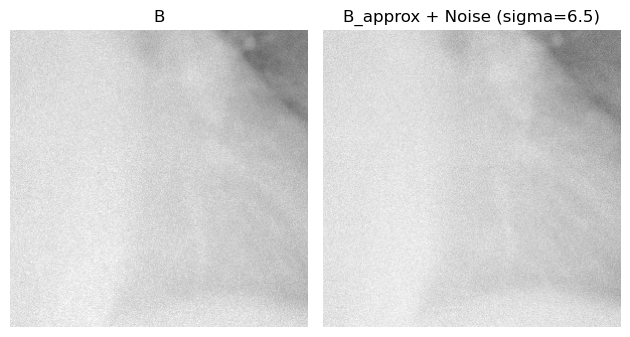

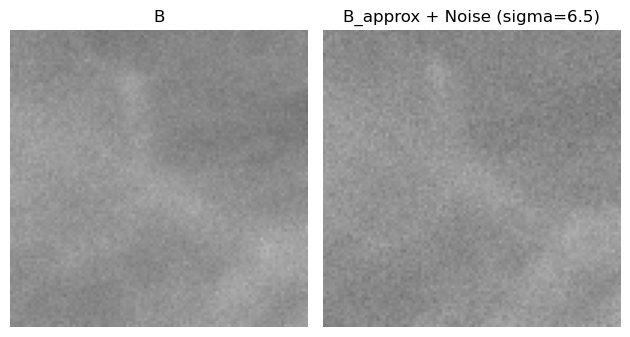

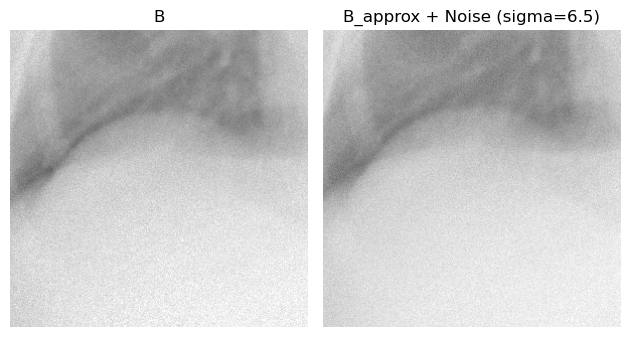

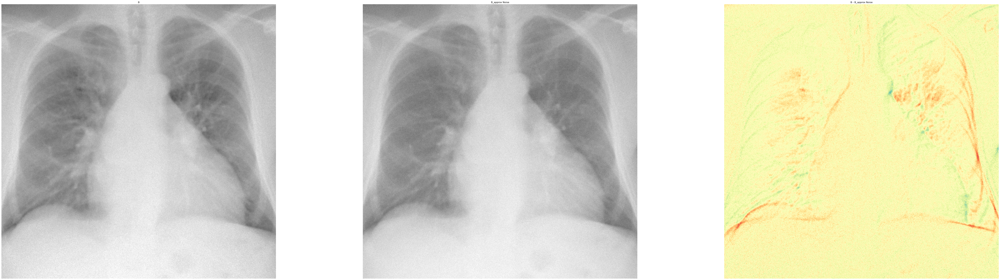

In [53]:

A = A_full
B = B_full

# Compute B_approx from A using regression model
B_approx = model.predict(A.flatten().numpy().reshape(-1, 1)).reshape(A.shape)

# Use consistent color scale
vmin = 0
vmax = 255

# Show A, B, and B_approx side by side
plt.figure(figsize=(80, 20))
plt.subplot(1, 4, 1)
plt.imshow(A.numpy(), cmap='gray', vmin=vmin, vmax=vmax)
plt.title('A')
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(B.numpy(), cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(B_approx, cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B_approx (Predicted)')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(B - B_approx, cmap='Spectral', vmin=-64, vmax=64)
plt.title('B - B_approx')
plt.axis('off')

plt.tight_layout()
plt.show()


print("Mean diff:", (B - B_approx).abs().mean())
print("MSE:", ((B - B_approx) ** 2).mean())

# INITAL TEST: blur: sigman 3-4 seems good?


NOISE_STD = 6.5
B_approx_noise = torch.normal(torch.from_numpy(B_approx),NOISE_STD)

plt.subplot(1, 2, 1)
plt.imshow(B[350:650, 350:650], cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(B_approx_noise[350:650, 350:650], cmap='gray', vmin=vmin, vmax=vmax)
plt.title(f'B_approx + Noise (sigma={NOISE_STD})')
plt.axis('off')


plt.tight_layout()
plt.show()


plt.subplot(1, 2, 1)
plt.imshow(B[400:500, 100:200], cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(B_approx_noise[400:500, 100:200], cmap='gray', vmin=vmin, vmax=vmax)
plt.title(f'B_approx + Noise (sigma={NOISE_STD})')
plt.axis('off')


plt.tight_layout()
plt.show()


plt.subplot(1, 2, 1)
plt.imshow(B[500:800, 000:300], cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(B_approx_noise[500:800, 000:300], cmap='gray', vmin=vmin, vmax=vmax)
plt.title(f'B_approx + Noise (sigma={NOISE_STD})')
plt.axis('off')


plt.tight_layout()
plt.show()



plt.figure(figsize=(80, 20))

plt.subplot(1, 3, 1)
plt.imshow(B.numpy(), cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(B_approx_noise, cmap='gray', vmin=vmin, vmax=vmax)
plt.title('B_approx Noise')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(B - B_approx, cmap='Spectral', vmin=-64, vmax=64)
plt.title('B - B_approx Noise')
plt.axis('off')

plt.tight_layout()
plt.show()
